In [1]:
import os

# os.environ["XFORMERS_DISABLED"] = "1"
import sys
from pathlib import Path

SCRIPT_DIR = Path(os.getcwd())  # Sets SCRIPT_DIR to the notebook's directory
print("SCRIPT_DIR:", SCRIPT_DIR)

# Add the neural_networks directory to sys.path for importing modules
sys.path.append(os.path.expanduser('~/projects/astroNNomy/src/astronnomy/training/'))
print("Updated sys.path:", sys.path)
from astronnomy.training.train_nn import *
from torchvision.transforms.functional import hflip
from torchvision.transforms import Resize
torch.set_float32_matmul_precision('high')
import copy
import matplotlib.pyplot as plt
import cv2
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler
# os.environ["XFORMERS_DISABLED"] = "1"

SCRIPT_DIR: /gpfs/home2/larsve/projects/astroNNomy/tests
Updated sys.path: ['/sw/arch/RHEL9/EB_production/2024/software/Python/3.12.3-GCCcore-13.3.0/lib/python312.zip', '/sw/arch/RHEL9/EB_production/2024/software/Python/3.12.3-GCCcore-13.3.0/lib/python3.12', '/sw/arch/RHEL9/EB_production/2024/software/Python/3.12.3-GCCcore-13.3.0/lib/python3.12/lib-dynload', '', '/home/larsve/projects/lofar_venv/lib/python3.12/site-packages', '/home/larsve/projects/astroNNomy/src/astronnomy/training/']


In [6]:
from cortexchange.wdclient import init_downloader
import os

# Make sure to store these variables.
login = os.getenv("WD_LOGIN")
password = os.getenv("WD_PASSWORD")


init_downloader(
    url="https://researchdrive.surfsara.nl/public.php/webdav/",
    cache=f"{os.path.join(os.path.expanduser('~'), '.cache/cortexchange')}",
    login=login,
    password=password,
)


from cortexchange.architecture import get_architecture, Architecture

Attempting authorization
Attempting authorization


In [7]:
TransferLearning: type(Architecture) = get_architecture("surf/TransferLearning")
model = TransferLearning(device="cuda", model_name="surf/dino_big_lora_default_pos_november_09876")
model.model.eval()

/home/larsve/projects/lofar_venv/lib/python3.12/site-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: '2.0.1' (you have '2.0.0'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
Using cache found in /home/larsve/.cache/torch/hub/facebookresearch_dinov2_main
/home/larsve/.cache/torch/hub/facebookresearch_dinov2_main/dinov2/layers/swiglu_ffn.py:43: UserWarning: xFormers is available (SwiGLU)
  warnings.warn("xFormers is available (SwiGLU)")
/home/larsve/.cache/torch/hub/facebookresearch_dinov2_main/dinov2/layers/attention.py:27: UserWarning: xFormers is available (Attention)
  warnings.warn("xFormers is available (Attention)")
/home/larsve/.cache/torch/hub/facebookresearch_dinov2_main/dinov2/layers/block.py:33: UserWarning: xFormers is available (Block)
  warnings.warn("xFormers is available (Block)")


768
Could not load optim due to 'ImagenetTransferLearning' object has no attribute 'classifier'; skipping.


In [2]:
img_per_label = 4
img_size = 560

In [3]:
train_loader, test_loader = get_dataloaders(
        "/scratch-shared/CORTEX/public.spider.surfsara.nl/lofarvwf/jdejong/CORTEX/calibrator_selection_robertjan/cnn_data/",
        img_per_label,
    )
mean, std = train_loader.dataset.compute_statistics(1)

In [4]:
for i, (img_continue, label_continue) in enumerate(test_loader):
    if label_continue.sum().item() != img_per_label:
        continue
    else:
        print(label_continue)
        break

tensor([1, 1, 1, 1])


In [5]:
for i, (img_stop, label_stop) in enumerate(test_loader):
    if label_stop.sum().item() != 0:
        continue
    else:
        print(label_stop)
        break

tensor([0, 0, 0, 0])


In [9]:
img_orig, label_orig = torch.cat((img_continue, img_stop)), torch.cat((label_continue, label_stop))
print(img_orig.shape)
# img, label = prepare_data(img_orig, label_orig, img_size, 1, "cuda", mean, std)
# img, label = img.to(torch.float32), label.to(torch.float32)


torch.Size([8, 1, 2048, 2048])


In [10]:
mean, std = model.args["dataset_mean"], model.args["dataset_std"]
img = model.prepare_batch(img_orig, mean=mean, std=std)


In [11]:
def PCA_pos(pos_embed, background_threshold=0.5, channels=3):
    pos_embed = pos_embed.cpu().squeeze()
    pca = PCA(n_components=channels)
    scaler = MinMaxScaler(clip=True)

    patches = pos_embed.shape[0]

    # First fit to seperate background and foreground
    pca.fit(pos_embed)
    pca_features = pca.transform(pos_embed)

    # MinMax Scaling
    scaler.fit(pca_features)
    pca_features = scaler.transform(pca_features)

    # Sometimes the predictions might come out slightly changed
    # you can play with the threshold to improve the outcome.
    pca_background = pca_features[:, 0] < background_threshold
    pca_foreground = ~pca_background

    # Second fit for the object
    pca.fit(pos_embed[pca_foreground])
    pca_features_rem = pca.transform(pos_embed[pca_foreground])

    scaler.fit(pca_features_rem)
    pca_features_rem = scaler.transform(pca_features_rem)


    # fig, axes = plt.subplots(1, np.ceil(channels / 3), figsize=(6 * len(img), 12))
    for color_start_idx in range(0, channels, 3):
        color_channels = channels - color_start_idx
        color_channels = 3 if channels > 1 else 1
        pca_features_rgb = np.zeros((patches, color_channels))
        pca_features_rgb[pca_background] = 0
        pca_features_rgb[pca_foreground, :color_channels] = pca_features_rem[:, color_start_idx:color_start_idx+color_channels]
        pca_features_rgb = pca_features_rgb.reshape(int(patches**0.5), int(patches**0.5), color_channels)
        plt.imshow(pca_features_rgb)
        plt.show()

In [12]:
def plot_PCA(img, model, label=None, background_threshold=0.5, channels=3):
    *_, h, w = img.shape
    patch_size = model.dino.encoder.patch_size
    h0, w0 = h // patch_size, w//patch_size
    patches = h0 * w0
    x = model.lift(img)
    n_images = len(img)
    features_dict = model.dino.encoder.forward_features(x)
    features = features_dict["x_norm_patchtokens"].detach().cpu().numpy()
    patch_features = features.reshape(n_images * patches, -1)
    preds = torch.nn.functional.sigmoid(model(img)).cpu().detach()
    channels = 3
    pca = PCA(n_components=channels)
    scaler = MinMaxScaler(clip=True)

    # First fit to seperate background and foreground
    print(patch_features.shape)
    pca.fit(patch_features)
    pca_features = pca.transform(patch_features)

    # MinMax Scaling
    scaler.fit(pca_features)
    pca_features = scaler.transform(pca_features)

    # Sometimes the predictions might come out slightly changed
    # you can play with the threshold to improve the outcome.
    pca_background = pca_features[:, 0] < background_threshold
    pca_foreground = ~pca_background

    # Second fit for the object
    pca.fit(patch_features[pca_foreground])
    pca_features_rem = pca.transform(patch_features[pca_foreground])

    scaler.fit(pca_features_rem)
    pca_features_rem = scaler.transform(pca_features_rem)

    color_channels = 3 if channels > 1 else 1

    pca_features_rgb = np.zeros((n_images * patches, color_channels))
    pca_features_rgb[pca_background] = 0
    pca_features_rgb[pca_foreground, :channels] = pca_features_rem
    pca_features_rgb = pca_features_rgb.reshape(len(img), h0, w0, color_channels)

    fig, axes = plt.subplots(2, len(img), figsize=(6 * len(img), 12))
    for i in range(len(img)):
        axes[0, i].imshow(pca_features_rgb[i], cmap='gray')
        axes[0, i].set_title(f"PCA components, preds = {preds[i].item():.3f}, \n avg_components: {','.join([str(np.round(val, 2)) for val in np.mean(pca_features_rgb[i], axis=(0, 1))])}")
        axes[0, i].axis("off")

        # Plot original images
        to_plot = (img.cpu()[i].movedim(0, 2) - img.cpu()[i].min())
        axes[1, i].imshow(to_plot/to_plot.max(), cmap='gray')
        if label is not None:
            axes[1, i].set_title(f"{'continue' if label[i] else 'stop'}")
        axes[1, i].axis("off")

    # plt.tight_layout()
    plt.show()

In [19]:
# model_path_dict = {'large_lora_pretrained_embed': "../../grid_search_lora/version_8636185_148__model_dinov2_vitl14_reg__lr_0.0001__normalize_1__dropout_p_0.1__use_compile_False__label_smoothing_0.1__stochastic_smoothing_False__use_lora_True__resize_560__rank_16__alpha_16.0__lift_stack__pos_embed_pre-trained/ckpt_step=1860.pth", 
#                     'big_lora_pretrained_embed': "../../grid_search_lora/version_8636427_169__model_dinov2_vitb14_reg__lr_5e-05__normalize_1__dropout_p_0.1__use_compile_False__label_smoothing_0.1__stochastic_smoothing_False__use_lora_True__resize_560__rank_32__alpha_32.0__lift_stack__pos_embed_pre-trained/ckpt_step=310.pth",
#                     'big_lora_fine_tune' : '../../grid_search_lora/version_8636427_211__model_dinov2_vitb14_reg__lr_1e-05__normalize_1__dropout_p_0.1__use_compile_False__label_smoothing_0.1__stochastic_smoothing_False__use_lora_True__resize_560__rank_32__alpha_32.0__lift_stack__pos_embed_fine-tune/ckpt_step=1860.pth',
#                    'big_no_lora_fine_tune' : "../../grid_search_lora/version_8636586_254__model_dinov2_vitb14_reg__lr_0.0001__normalize_1__dropout_p_0.1__use_compile_False__label_smoothing_0.1__stochastic_smoothing_False__use_lora_False__resize_560__rank_32__alpha_32.0__lift_stack__pos_embed_fine-tune/ckpt_step=2480.pth",
#                    'large_no_lora_zeros' : "../../grid_search_lora/version_8636586_257__model_dinov2_vitl14_reg__lr_0.0001__normalize_1__dropout_p_0.1__use_compile_False__label_smoothing_0.1__stochastic_smoothing_False__use_lora_False__resize_560__rank_32__alpha_32.0__lift_stack__pos_embed_zeros/ckpt_step=2604.pth",
#                    'big_lora_zeros': "../../grid_search_lora/version_8636427_228__model_dinov2_vitb14_reg__lr_0.0001__normalize_1__dropout_p_0.1__use_compile_False__label_smoothing_0.1__stochastic_smoothing_False__use_lora_True__resize_560__rank_32__alpha_32.0__lift_stack__pos_embed_zeros/ckpt_step=2852.pth",
#                    }

Using cache found in /home/larsve/.cache/torch/hub/facebookresearch_dinov2_main


1024
Could not load optim due to 'ImagenetTransferLearning' object has no attribute 'classifier'; skipping.
large_lora_pretrained_embed
torch.Size([1, 1370, 1024])


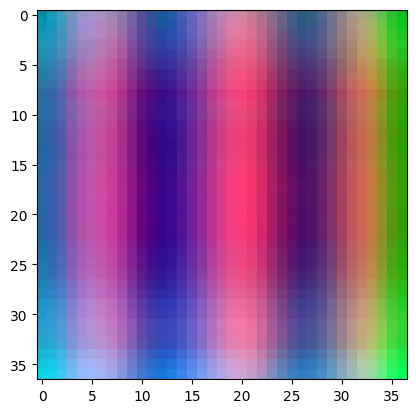

Using cache found in /home/larsve/.cache/torch/hub/facebookresearch_dinov2_main


768
Could not load optim due to 'ImagenetTransferLearning' object has no attribute 'classifier'; skipping.
big_lora_pretrained_embed
torch.Size([1, 1370, 768])


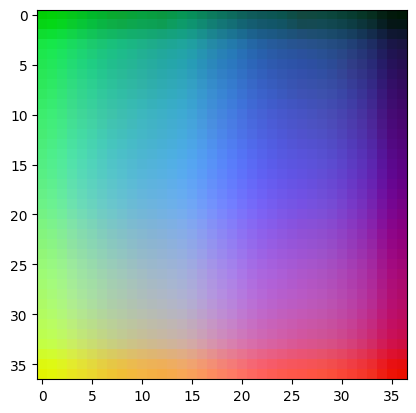

In [21]:
# for model_name, load_path in list(model_path_dict.items())[:2]:
#     model_dict = load_checkpoint(load_path)
#     model = model_dict["model"].to("cuda")
#     model.eval()
#     for param in model.parameters():
#         param.requires_grad = False
#     print(model_name)
#     print(model.dino.encoder.pos_embed.shape)
#     PCA_pos(model.dino.encoder.pos_embed[:, 1:, :], background_threshold=0, channels=3)

large_lora_pretrained_embed


Using cache found in /home/larsve/.cache/torch/hub/facebookresearch_dinov2_main


1024
Could not load optim due to 'ImagenetTransferLearning' object has no attribute 'classifier'; skipping.
(12800, 1024)


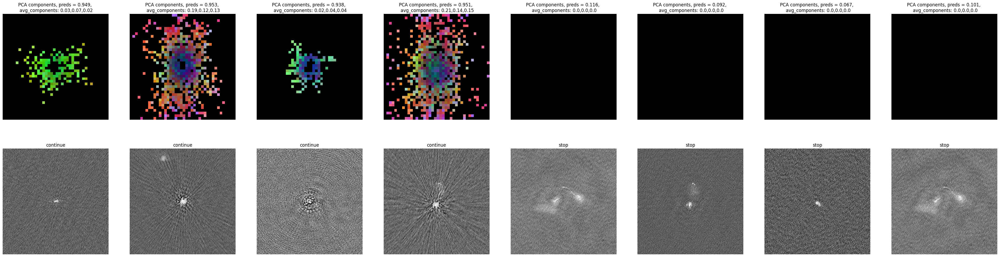

(12800, 1024)


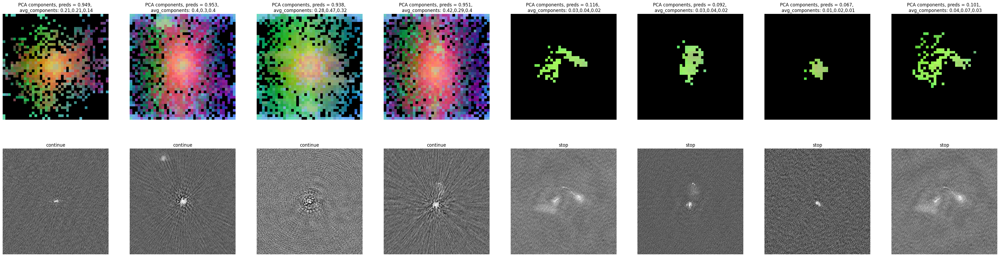

(12800, 1024)


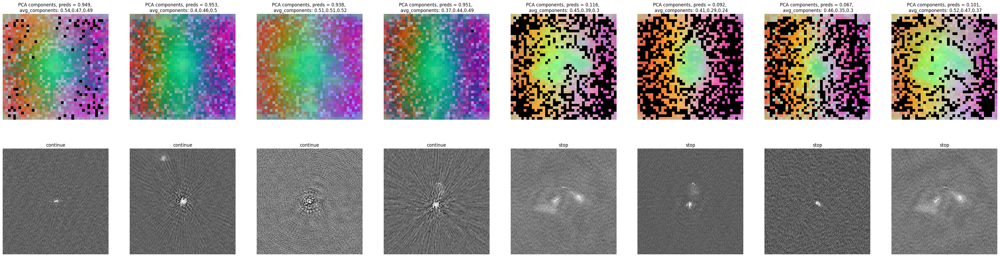

(12800, 1024)


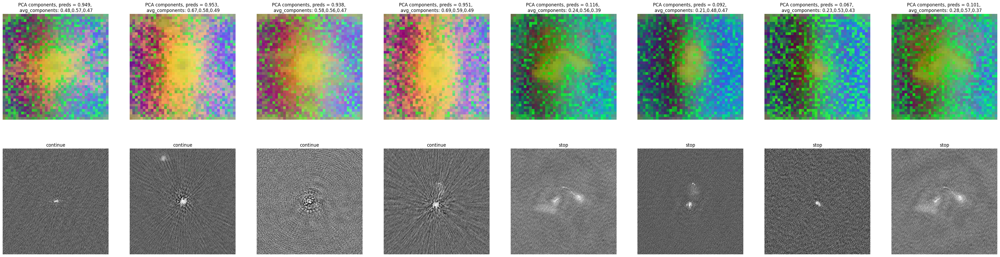

big_lora_pretrained_embed


Using cache found in /home/larsve/.cache/torch/hub/facebookresearch_dinov2_main


768
Could not load optim due to 'ImagenetTransferLearning' object has no attribute 'classifier'; skipping.
(12800, 768)


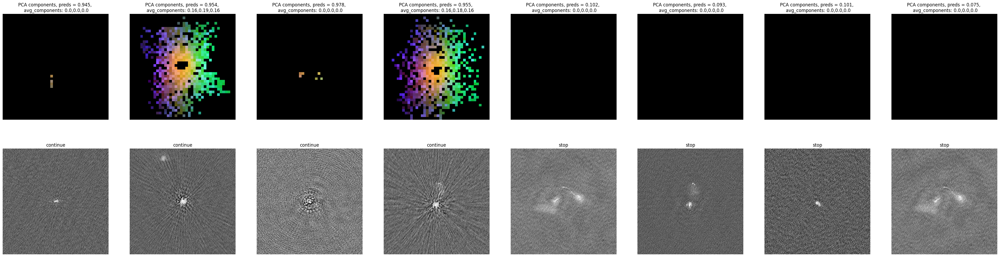

(12800, 768)


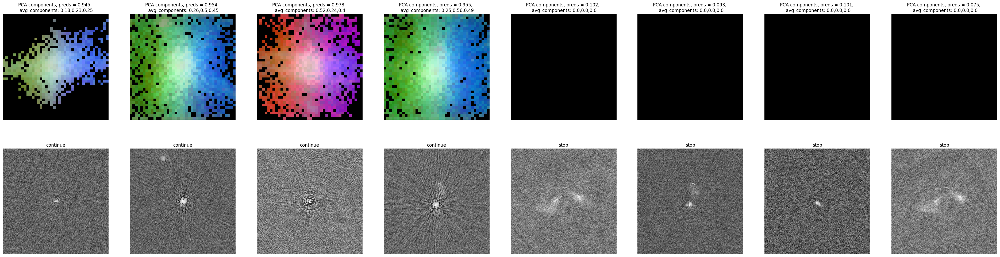

(12800, 768)


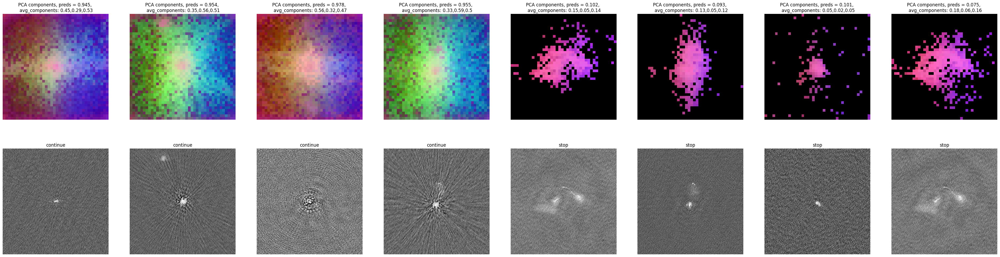

(12800, 768)


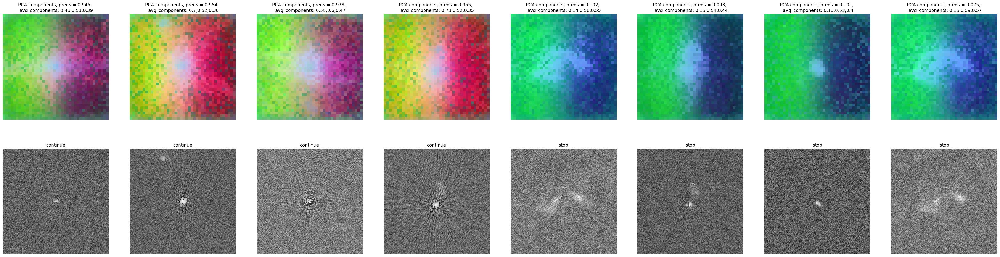

In [11]:
for model_name, load_path in list(model_path_dict.items())[:2]:
    print(model_name)
    model_dict = load_checkpoint(load_path)
    model = model_dict["model"].to("cuda")
    model.eval()
    for param in model.parameters():
        param.requires_grad = False
    plot_PCA(img, model, label=label, background_threshold=0.8)
    plot_PCA(img, model, label=label, background_threshold=0.5)
    plot_PCA(img, model, label=label, background_threshold=0.2)
    plot_PCA(img, model, label=label, background_threshold=0)

In [ ]:
for model_name, load_path in list(model_path_dict.items())[:2]:
    print(model_name)
    model_dict = load_checkpoint(load_path)
    model = model_dict["model"].to("cuda")
    model.eval()
    for param in model.parameters():
        param.requires_grad = False
    images_black = torch.zeros_like(img)
    plot_PCA(images_black, model, background_threshold=0)

In [ ]:
images_white = torch.ones_like(img)
plot_PCA(images_white, model, background_threshold=0)

In [ ]:
images_noise = torch.randn_like(img)
plot_PCA(images_noise, model, background_threshold=0)

In [ ]:
plot_PCA(img, model, label=label, background_threshold=0.8)

In [ ]:
pos_embed = model.dino.encoder.pos_embed[:, 1:, :].clone()

In [ ]:

pos_embed_zeros = torch.zeros_like(pos_embed)
pos_embed_ones = torch.ones_like(pos_embed)
pos_embed_avg = torch.ones_like(pos_embed) * torch.mean(pos_embed)
pos_embed_avg_vec = torch.ones_like(pos_embed) * torch.mean(pos_embed, axis=1, keepdim=True)
h_patch = w_patch = int(pos_embed.shape[1]**0.5) 
pos_embed_transposed = pos_embed.clone().reshape(h_patch, w_patch, pos_embed.shape[-1]).swapdims(0, 1).reshape(-1, pos_embed.shape[-1])
pos_embed_randn = torch.normal(torch.ones_like(pos_embed) * torch.mean(pos_embed), torch.ones_like(pos_embed) * torch.std(pos_embed), out=torch.empty_like(pos_embed))
pos_embed_dict = {'orig': pos_embed, 'orig_transpose': pos_embed_transposed, 'zeros': pos_embed_zeros, 'ones': pos_embed_ones, 'avg': pos_embed_avg, 'avg_vec': pos_embed_avg_vec, 'randn': pos_embed_randn}

for embed_name, pos_embedding in pos_embed_dict.items():
    model.dino.encoder.pos_embed[:, 1:, :] = pos_embedding
    
    print(embed_name)
    for img_size in [518, 1120]:
        if 'orig' in embed_name or 'rand' in embed_name:
            # PCA_pos(pos_embedding, background_threshold=0)
            upscaled_pos_embed = model.dino.encoder.interpolate_pos_encoding(torch.randn((1, (img_size // 14)**2, pos_embed.shape[-1])), img_size, img_size)[:, 1:, :]
            print(pos_embed.shape, upscaled_pos_embed.shape)
            PCA_pos(upscaled_pos_embed, background_threshold=0)
        img2, label2 = prepare_data(img_orig, label_orig, img_size, 1, "cuda", mean, std)
        img2, label2 = img2.to(torch.float32), label2.to(torch.float32)
        plot_PCA(img2, model, background_threshold=0.75)

model.dino.encoder.pos_embed[:, 1:, :] = pos_embed